Experimental Dataset - 2D class - class 39- 128x128

# Setup

In [1]:
%matplotlib inline
import os, sys, glob, shutil
from matplotlib import pyplot as plt
import numpy as np
import torch
import h5py
from sklearn import metrics
sys.path.append('../utils/')
import functions_for_fred as fn
import nn
import viz
import pred

In [2]:
print('we are here {}'.format(os.getcwd()))

we are here /gpfs/slac/cryo/fs1/g/ML/vaegan/analysis


In [3]:
KEYWORD      = 'cryo_exp_class_2d_39_128x128'
CHECKPT_FILE = 'cryo_exp_class_2d_39_epoch_255_checkpoint.pth'
EPOCH_NUMBER = 255

In [4]:
DATASET_DIR     = '../train_val_datasets/'
METADATASET_DIR = '../datasets/exp/20181005-rib-TEM4/Sort/'
TRAINED_DIR = '../train_vae/'
TRAIN_DATASET_PATH     = DATASET_DIR+KEYWORD+'.npy'
TRAIN_METADATASET_PATH = METADATASET_DIR+'class2D_39_sort.h5'
TRAINED_CHECKPOINT     = 'epoch_'+str(EPOCH_NUMBER)+'_checkpoint.pth'
if not os.path.exists(KEYWORD):
    os.makedirs(KEYWORD)
if not os.path.exists(KEYWORD+'/train_vae'):
    os.makedirs(KEYWORD+'/train_vae')
if not os.path.isfile(KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT):
    shutil.copyfile(TRAINED_DIR+CHECKPT_FILE, KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT)

# Load dataset, encoder and decoder

In [5]:
dataset = np.load(TRAIN_DATASET_PATH)
metadata = h5py.File(TRAIN_METADATASET_PATH, 'r')
print('dataset.shape {} metadata.shape {}'.format(dataset.shape, metadata['particles'].shape))

dataset.shape (5119, 1, 128, 128) metadata.shape (5119, 180, 180)


In [6]:
mus = []
mus = fn.latent_projection(KEYWORD, TRAIN_DATASET_PATH, epoch_id=EPOCH_NUMBER)
mus.shape

cryo_exp_class_2d_39_128x128/train_vae/epoch_255_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_39_128x128/train_vae/epoch_255_checkpoint.pth.
Loading encoder from network of architecture: conv_orig...


(5119, 4)

In [7]:
recon = []
recon = fn.reconstruction(KEYWORD, torch.Tensor(mus[0:500,...]).cuda(), epoch_id=EPOCH_NUMBER)
recon.shape

cryo_exp_class_2d_39_128x128/train_vae/epoch_255_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_39_128x128/train_vae/epoch_255_checkpoint.pth.
Loading decoder from network of architecture: conv_orig...


(500, 1, 128, 128)

In [8]:
list(metadata.keys())

['_rlnamplitudecontrast',
 '_rlnanglepsi',
 '_rlnanglerot',
 '_rlnangletilt',
 '_rlnautopickfigureofmerit',
 '_rlnclassnumber',
 '_rlncoordinatex',
 '_rlncoordinatey',
 '_rlnctfbfactor',
 '_rlnctffigureofmerit',
 '_rlnctfmaxresolution',
 '_rlnctfscalefactor',
 '_rlndefocusangle',
 '_rlndefocusu',
 '_rlndefocusv',
 '_rlndetectorpixelsize',
 '_rlngroupnumber',
 '_rlnimagename',
 '_rlnloglikelicontribution',
 '_rlnmagnification',
 '_rlnmaxvalueprobdistribution',
 '_rlnmicrographname',
 '_rlnnormcorrection',
 '_rlnnrofsignificantsamples',
 '_rlnoriginx',
 '_rlnoriginy',
 '_rlnparticleselectzscore',
 '_rlnphaseshift',
 '_rlnsphericalaberration',
 '_rlnvoltage',
 'particles']

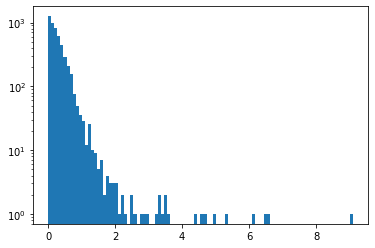

0.29390269770115257 0.38519839204161177


In [9]:
Zscore = np.array(metadata['_rlnparticleselectzscore'])
plt.hist(Zscore, bins=100, log=True)
plt.show()
print(np.mean(Zscore), np.std(Zscore))

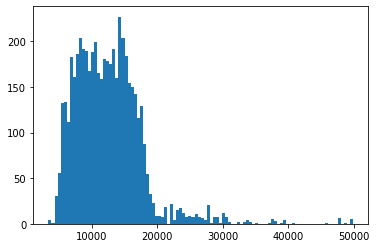

3333.739502 12408.233953110177 5213.635159191951


In [10]:
defocus = np.array(metadata['_rlndefocusu'])
plt.hist(defocus, bins=100, log=False)
plt.show()
print(np.min(defocus),np.mean(defocus), np.std(defocus))

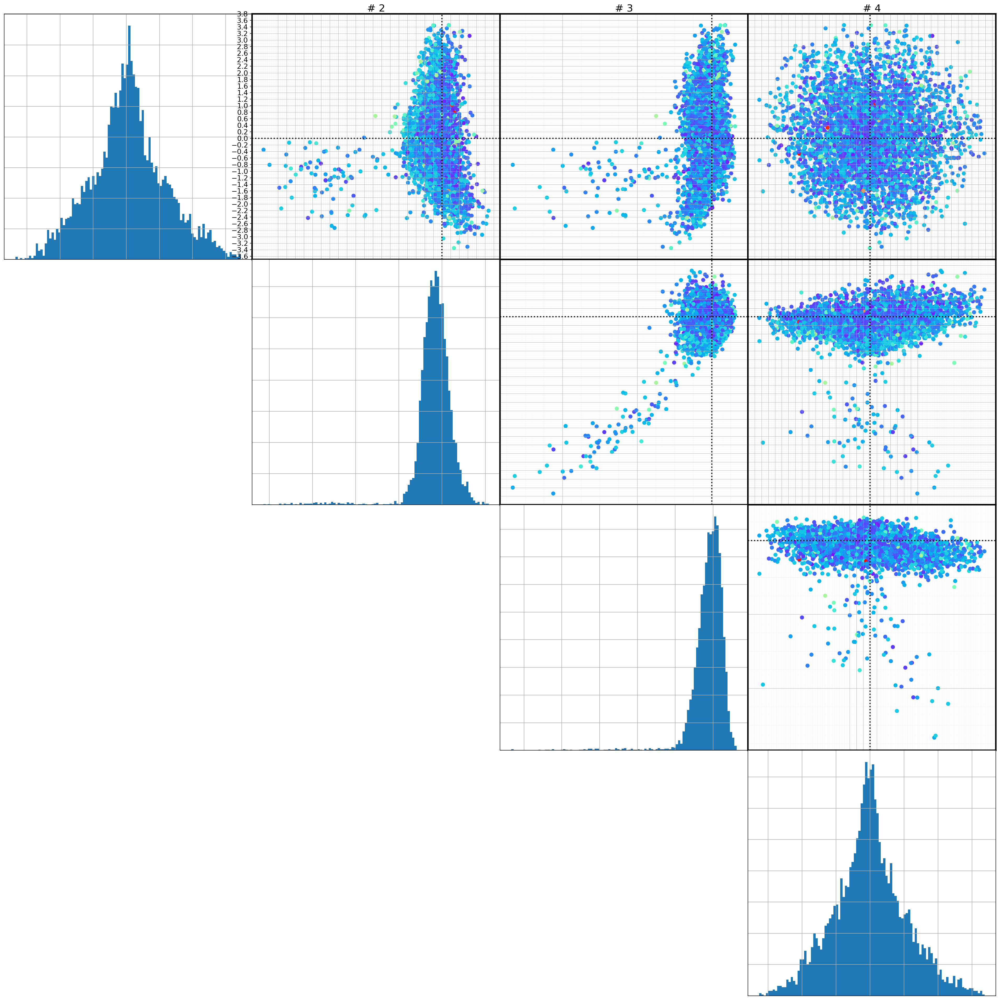

In [11]:
viz.biplots(mus, n=4, show_histo=True, nbins=100, c=metadata['_rlndefocusu'], 
            figname=KEYWORD+'/latent_space_defocus_true')

In [12]:
center = np.mean(mus,axis=0) #np.zeros(mus.shape) #
U, L, Vt = np.linalg.svd(mus - center, full_matrices=False)

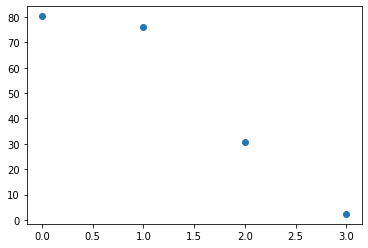

In [13]:
plt.plot(L, 'o')

In [ ]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=metadata['_rlndefocusu'], 
            figname=KEYWORD+'/latent_space_pca_defocus_true')

# Data curation

## Outlier prediction

In [14]:
Zscore_set=2

In [15]:
positives = np.where(Zscore<Zscore_set)[0]
negatives = np.where(Zscore>Zscore_set)[0]
print(positives.shape,negatives.shape)

(5090,) (29,)


AUC(robust_covar) = 0.8631190298760246
AUC(isolation_forest) = 0.8468735180543324
AUC(local_outlier_detection) = 0.6733825621570354


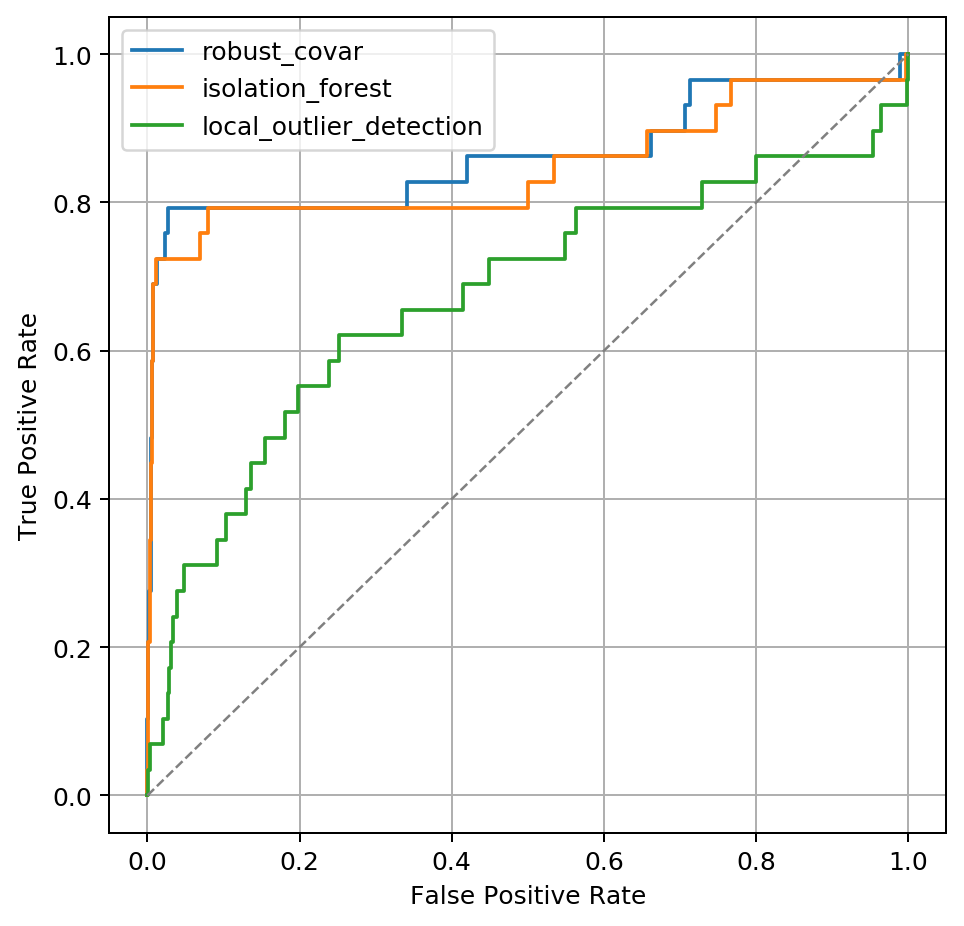

In [16]:
methods = ['robust_covar', 'isolation_forest', 'local_outlier_detection']
#
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,tpr)
    print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_Zscore'+str(Zscore_set))
#

In [17]:
measure, offset, assignment = pred.outlier_measure(mus, method='robust_covar')

In [ ]:
viz.biplots(mus, n=4, show_histo=True, nbins=100, c=measure, figname=KEYWORD+'/latent_space_robust_covar')

In [18]:
measure_threshold=5

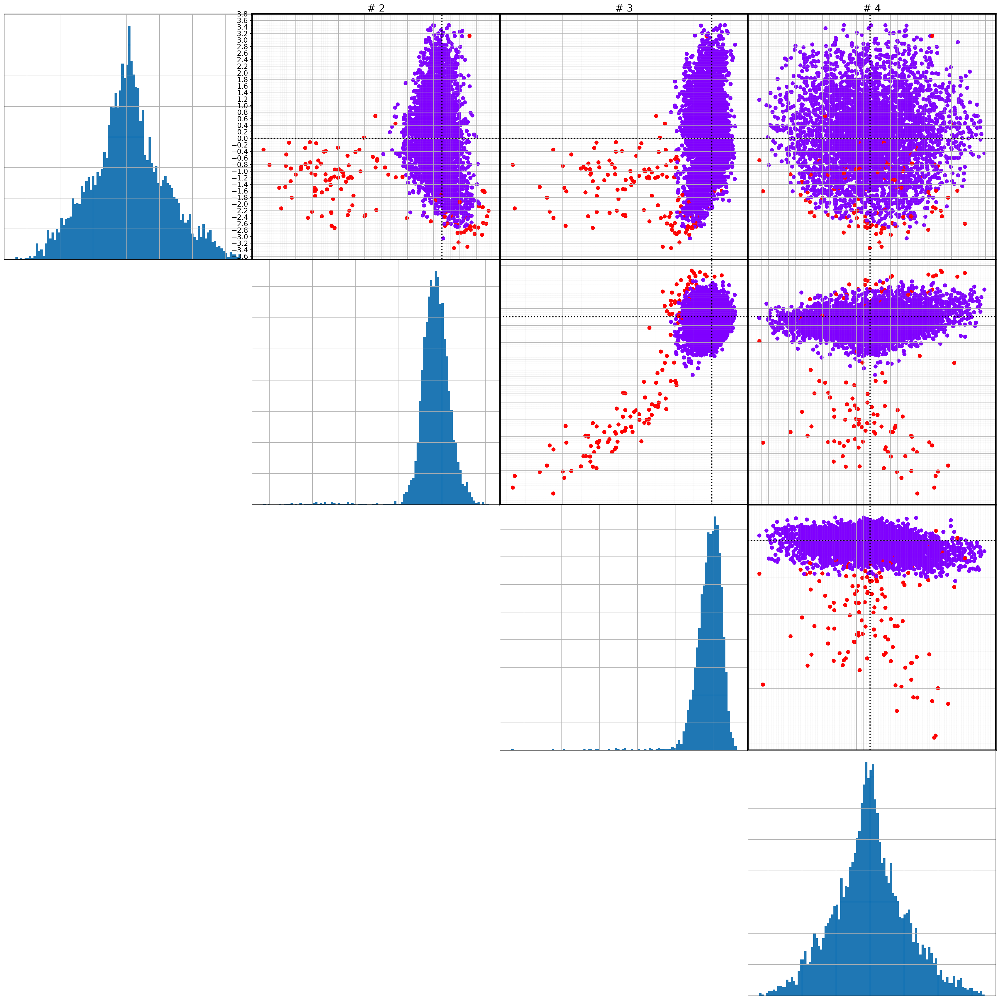

In [24]:
viz.biplots(mus, n=4, show_histo=True, nbins=100, c=np.where(measure<measure_threshold,0,1), 
            figname=KEYWORD+'/latent_space_robust_covar_assigned')

In [19]:
mus_kept = mus[np.where(measure<measure_threshold),:][0,...]
print(mus_kept.shape)
defocus_kept = np.array(metadata['_rlndefocusu'])[np.where(measure<measure_threshold)]
print(defocus_kept.shape)
angle_kept = np.array(metadata['_rlnanglepsi'])[np.where(measure<measure_threshold)]
print(angle_kept.shape)
Zscore_kept = np.array(metadata['_rlnparticleselectzscore'])[np.where(measure<measure_threshold)]
print(Zscore_kept.shape)

(4991, 4)
(4991,)
(4991,)
(4991,)


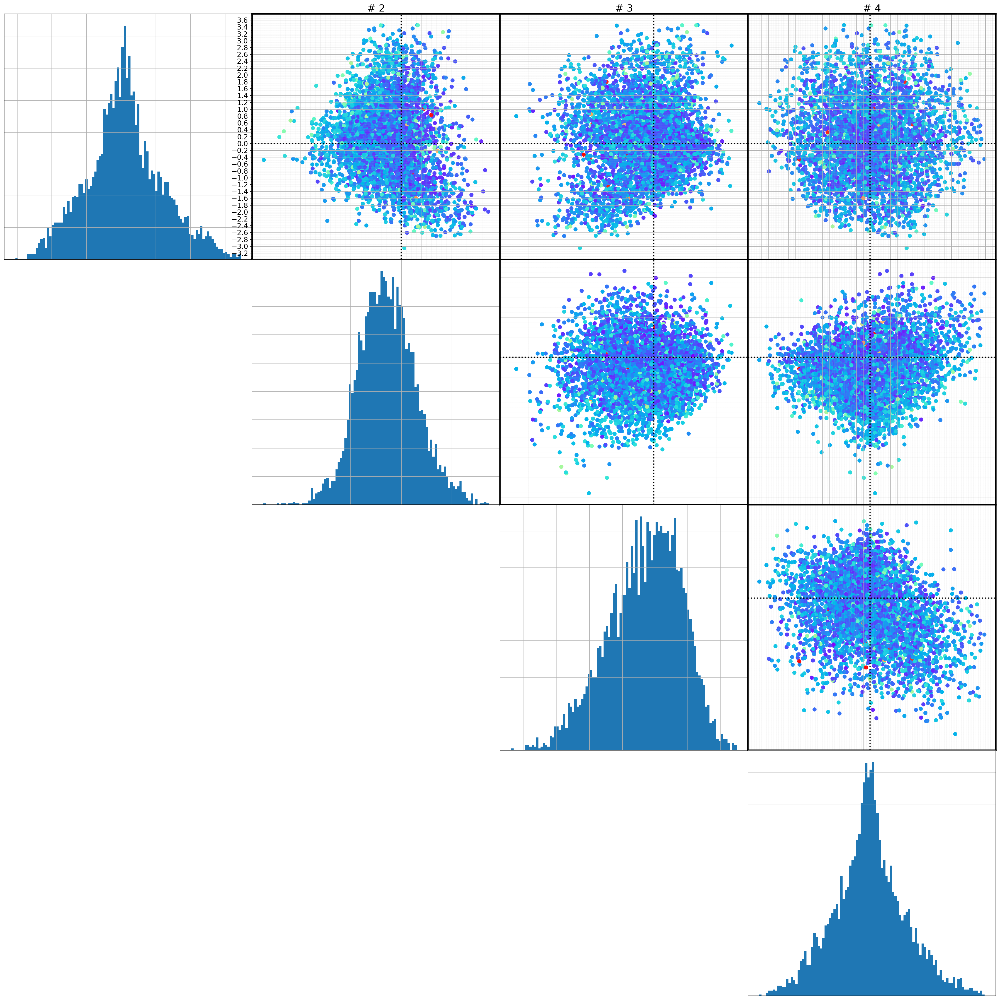

In [25]:
viz.biplots(mus_kept, n=4, show_histo=True, nbins=100, c=defocus_kept)

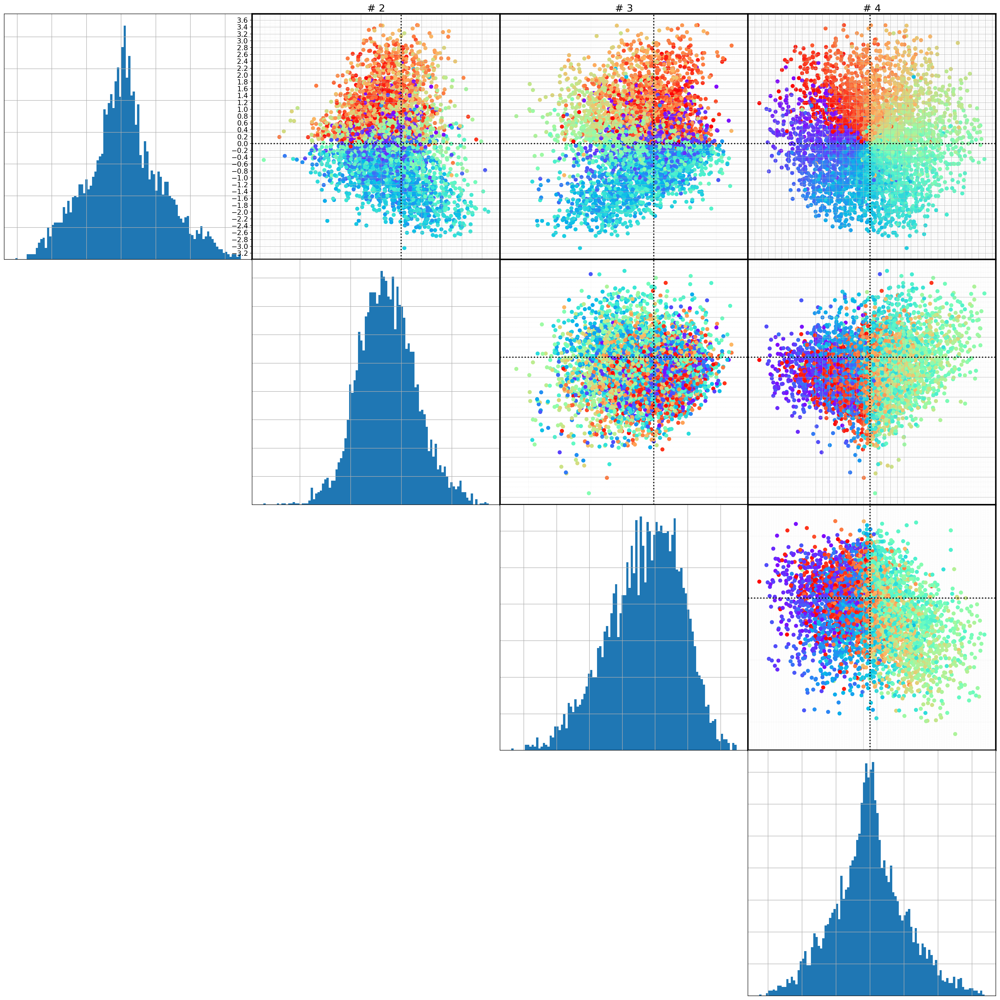

In [26]:
viz.biplots(mus_kept, n=4, show_histo=True, nbins=100, c=angle_kept)

## Remove user-defined outliers

In our case, knowledge of metadata helps getting rid of "bad" data (i.e. defocus values out of reasonable range)

In [20]:
index = np.where((defocus_kept>5000)  & (defocus_kept < 25000))[0]
mus_curated     = mus_kept[index,:]
angle_curated   = angle_kept[index]
defocus_curated = defocus_kept[index]
Zscore_curated  = Zscore_kept[index]

# Project in PCA space

In [21]:
center_curated = np.mean(mus_curated,axis=0) #np.zeros(mus.shape) #
U_curated, L_curated, Vt_curated = np.linalg.svd(mus_curated - center_curated, full_matrices=False)

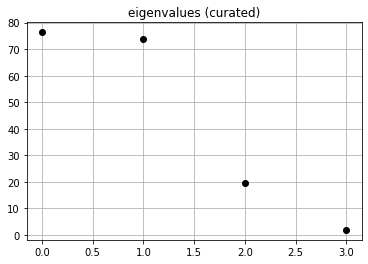

In [22]:
plt.plot(L_curated, 'ko')
plt.title('eigenvalues (curated)')
plt.grid()
plt.show()

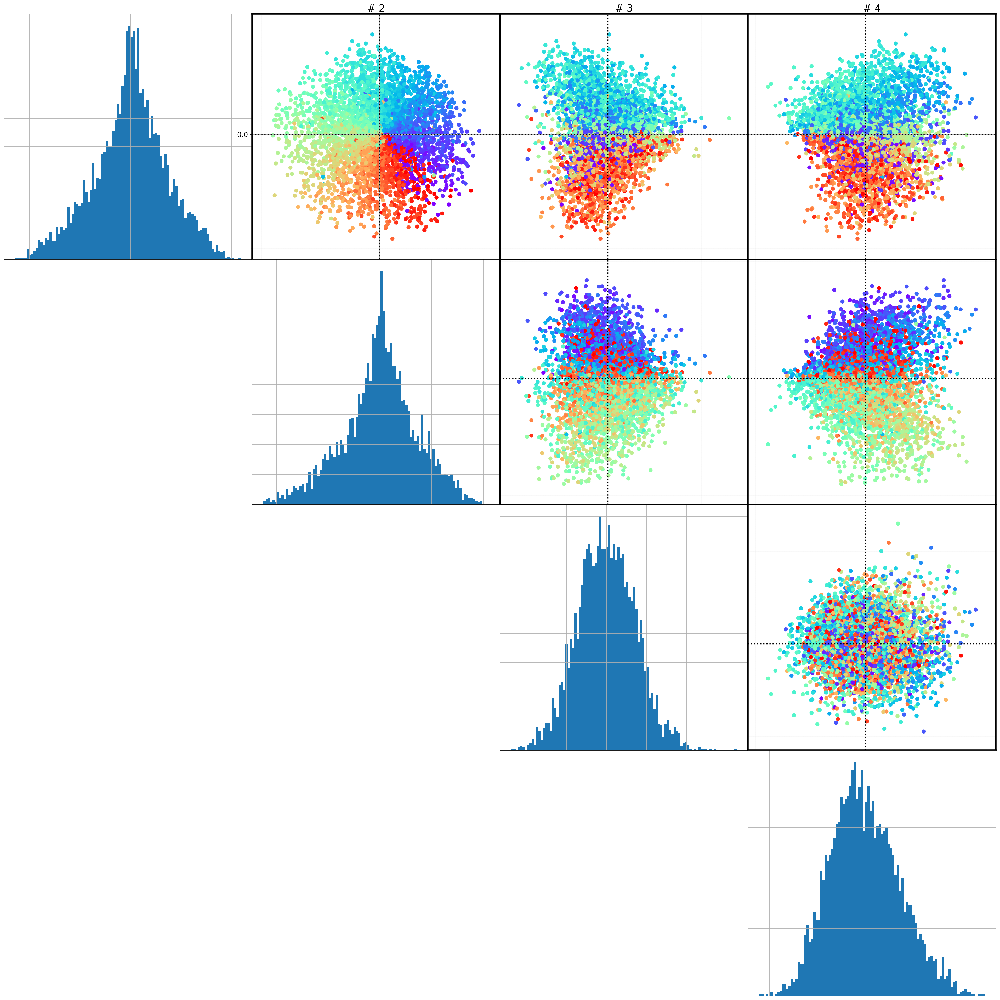

In [27]:
viz.biplots(U_curated, n=4, show_histo=True, nbins=100, c=angle_curated)

In [ ]:
viz.biplots(U_curated, n=4, show_histo=True, nbins=100, c=defocus_curated)

# Parameter prediction

## Simple ellipse fitting

In [126]:
angle_true   = angle_curated + 180
defocus_true = defocus_curated

## stable portion

In [174]:
angle_pred, defocus_pred = pred.pred2d(U_curated, angle_true, defocus_true, 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

In [175]:
defocus_pred

array([18025.914, 12314.575,  9786.043, ...,  6449.372, 10116.529,
       11388.66 ], dtype=float32)

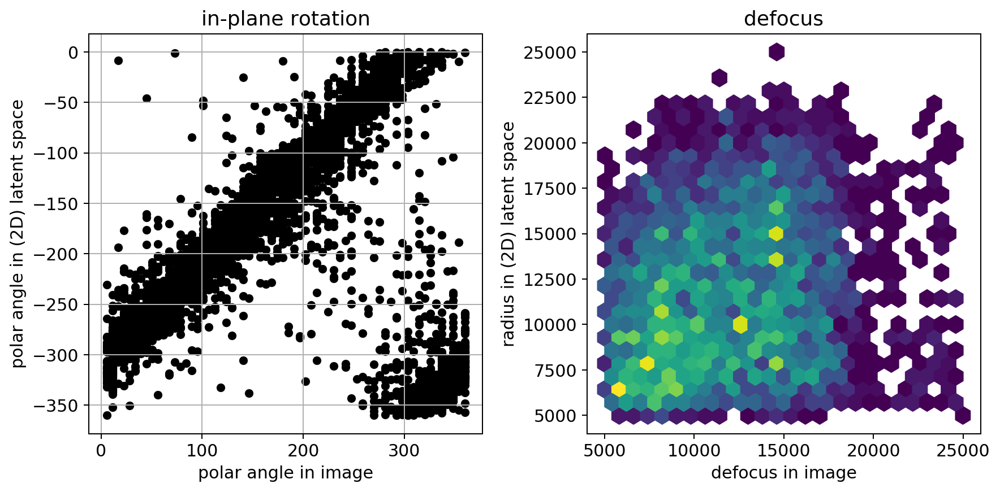

In [176]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_prediction_ellipse_rest')

offset: -300 angle RMSE = 113.67866104028931
offset: -280 angle RMSE = 131.86865222253073
offset: -260 angle RMSE = 149.2442977014868
offset: -240 angle RMSE = 162.11536067890097
offset: -220 angle RMSE = 159.27339039763032
offset: -200 angle RMSE = 144.84178887870664
offset: -180 angle RMSE = 127.30747815692811
offset: -160 angle RMSE = 109.10665702493546
offset: -140 angle RMSE = 90.77314967101027
offset: -120 angle RMSE = 72.72135302498715
offset: -100 angle RMSE = 55.72082222924285
offset: -80 angle RMSE = 40.99925444008604
offset: -60 angle RMSE = 31.800525606303815
offset: -40 angle RMSE = 33.31953964586272
offset: -20 angle RMSE = 44.47613704522444
offset: 0 angle RMSE = 59.97550499278508
offset: 20 angle RMSE = 77.2992224894254
offset: 40 angle RMSE = 95.36693571193057
offset: 60 angle RMSE = 113.67866101740006
offset: 80 angle RMSE = 131.86865215148657
offset: 100 angle RMSE = 149.2442975329928
offset: 120 angle RMSE = 162.11536063128395
offset: 140 angle RMSE = 159.2733903455

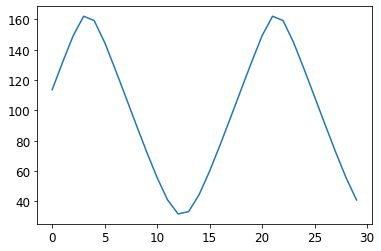

In [177]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-300,300,20))
plt.plot(angle_RMSE_list)

### weight angle RMSE with defocus pred

In [178]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

offset: -56.0 angle RMSE = 20.670838795315003
offset: -55.75 angle RMSE = 20.640479127322436
offset: -55.5 angle RMSE = 20.6130566100932
offset: -55.25 angle RMSE = 20.58863345051837
offset: -55.0 angle RMSE = 20.56722031954583
offset: -54.75 angle RMSE = 20.548826630344664
offset: -54.5 angle RMSE = 20.533460500835556
offset: -54.25 angle RMSE = 20.521128710194198
offset: -54.0 angle RMSE = 20.51183677527629
offset: -53.75 angle RMSE = 20.505588803862125
offset: -53.5 angle RMSE = 20.502387572223007
offset: -53.25 angle RMSE = 20.502234528564657
offset: -53.0 angle RMSE = 20.505129713388463
offset: -52.75 angle RMSE = 20.51107086439855
offset: -52.5 angle RMSE = 20.51984091321159
offset: -52.25 angle RMSE = 20.531579879880674
defocus RMSE = 5281.887840230124


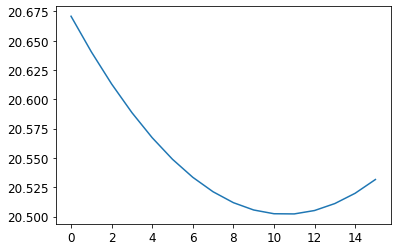

In [182]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-56,-52,0.25),
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), norm_weights=True)
plt.plot(angle_RMSE_list)

offset: -31.0 angle RMSE = 37.59194203345913
offset: -30.75 angle RMSE = 37.729089832190965
offset: -30.5 angle RMSE = 37.867141829178756
offset: -30.25 angle RMSE = 38.0063199399162
offset: -30.0 angle RMSE = 38.146628684012434
offset: -29.75 angle RMSE = 38.28805564545315
offset: -29.5 angle RMSE = 38.430588463778136
offset: -29.25 angle RMSE = 38.574214891516824
offset: -29.0 angle RMSE = 38.7187816279562
offset: -28.75 angle RMSE = 38.86352344318931
offset: -28.5 angle RMSE = 39.00921069859276
offset: -28.25 angle RMSE = 39.15595208746358
offset: -28.0 angle RMSE = 39.30373580864904
offset: -27.75 angle RMSE = 39.45255014947325
offset: -27.5 angle RMSE = 39.60238348706076
offset: -27.25 angle RMSE = 39.75272841388471
defocus RMSE = 5281.887840230124


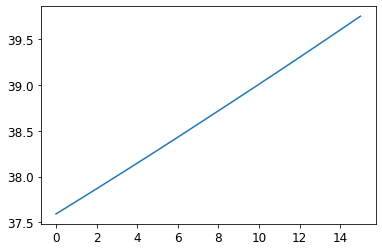

In [133]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-31,-27,0.25),
                                                angle_weight=np.exp(-np.abs(Zscore[index])), norm_weights=True)
plt.plot(angle_RMSE_list)

offset: -54.0 angle RMSE = 20.51183677527629
offset: -53.75 angle RMSE = 20.505588803862125
offset: -53.5 angle RMSE = 20.502387572223007
offset: -53.25 angle RMSE = 20.502234528564657
offset: -53.0 angle RMSE = 20.505129713388463
offset: -52.75 angle RMSE = 20.51107086439855
offset: -52.5 angle RMSE = 20.51984091321159
offset: -52.25 angle RMSE = 20.531579879880674
defocus RMSE = 5281.887840230124


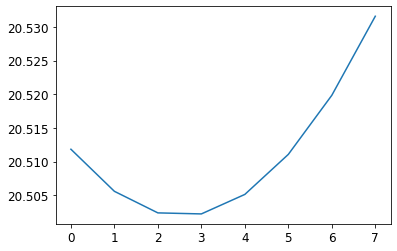

In [135]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-54,-52,0.25),
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), norm_weights=True)
plt.plot(angle_RMSE_list)

## Cone fitting (ad-hoc)

In [173]:
from scipy.stats import special_ortho_group
from scipy.optimize import curve_fit

def f(x, A, B): # this is your 'straight line' y=f(x)
    return A*x + B

nsample=1000 #10000
ax = np.empty((nsample,3))
ay = np.empty((nsample,3))
az = np.empty((nsample,3))
ax[0,...] = [1,0,0]
ay[0,...] = [0,1,0]
az[0,...] = [0,0,1]
score_list = []

rotmat = np.diag([1,1,1])
U_rotated = np.dot(rotmat,U_curated[:,0:3].T).T
popt, pcov = curve_fit(f, U_rotated[:,2], np.linalg.norm(U_rotated[:,0:2],axis=1))
score = np.abs(popt[0])
score_max  = score
rotmat_max = rotmat
center_max = center
ibest = 0
score_list.append(score)
print(ibest,score_max)
for i in np.arange(1,nsample):
    rotmat = special_ortho_group.rvs(3)
    ax[i,...] = np.dot(rotmat,ax[0,...])
    ay[i,...] = np.dot(rotmat,ay[0,...])
    az[i,...] = np.dot(rotmat,az[0,...])
    U_rotated = np.dot(rotmat,U_curated[:,0:3].T).T
    popt, pcov = curve_fit(f, U_rotated[:,2], np.linalg.norm(U_rotated[:,0:2],axis=1))
    score = np.abs(popt[0])
    if(score > score_max):
        ibest = i
        score_max = score
        rotmat_max = rotmat
        center_max = center
        print(i,score_max)
    score_list.append(score)

0 0.3081232432010803
104 0.30928393670226695
225 0.31109032449794405
276 0.3144215740454403
326 0.31551071214858983
438 0.3168894322268905


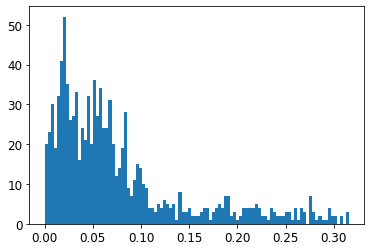

In [152]:
plt.hist(score_list, bins=np.int(nsample/10))
plt.show()

In [153]:
U_best = np.dot(rotmat_min,U_curated[:,0:3].T).T#(np.dot(rotmat_min,U_curated[:,0:3].T).T)
print(U_best.shape, U_curated.shape)

(4798, 3) (4798, 4)


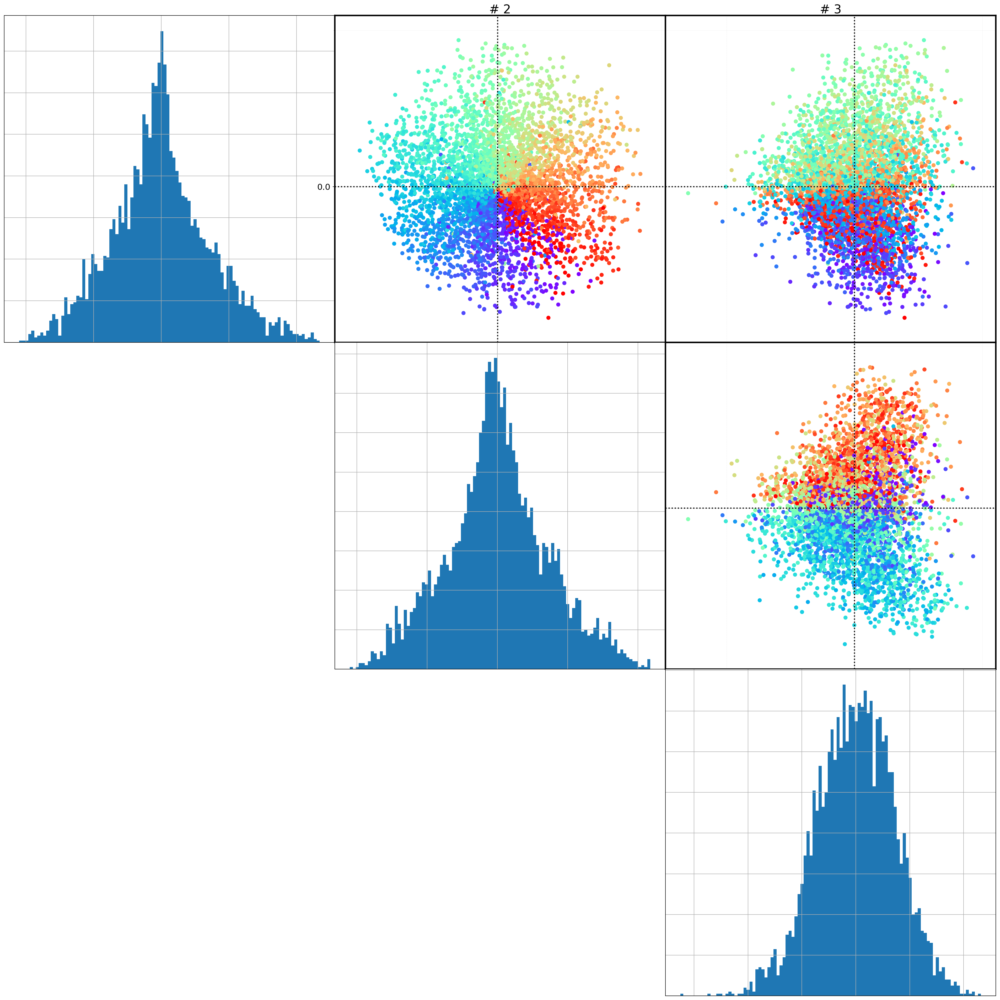

In [154]:
viz.biplots(U_best, n=3, show_histo=True, nbins=100, c=angle_true)

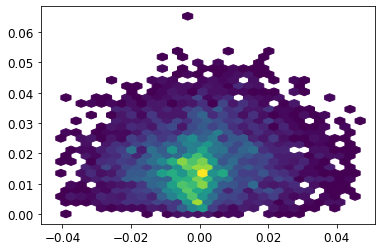

In [155]:
plt.hexbin(U_best[:,0],np.linalg.norm(U_best[:,1:3],axis=1), mincnt=1, gridsize=30)

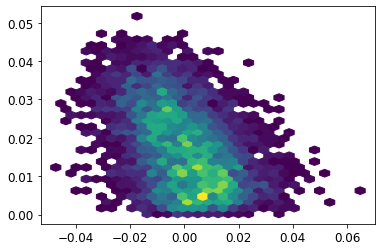

In [157]:
plt.hexbin(U_curated[:,2],np.linalg.norm(U_curated[:,0:2],axis=1), mincnt=1, gridsize=30)

In [160]:
angle_pred, defocus_pred = pred.pred2d(U_best, angle_true, defocus_true, 
                                       angle_pred_sign=1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

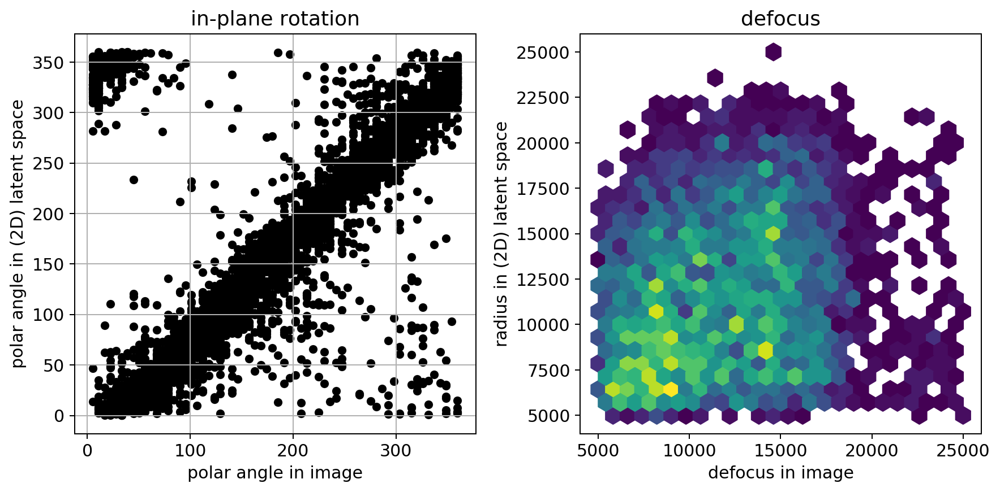

In [161]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_prediction_ellipse_rest')

offset: 24.0 angle RMSE = 31.18528127703608
offset: 24.25 angle RMSE = 31.17129729299414
offset: 24.5 angle RMSE = 31.15931291810831
offset: 24.75 angle RMSE = 31.149330460363966
offset: 25.0 angle RMSE = 31.141351844923573
offset: 25.25 angle RMSE = 31.135378612274693
offset: 25.5 angle RMSE = 31.131411916745105
offset: 25.75 angle RMSE = 31.129452525388654
offset: 26.0 angle RMSE = 31.12898099313682
offset: 26.25 angle RMSE = 31.130434443481942
offset: 26.5 angle RMSE = 31.13389534910113
offset: 26.75 angle RMSE = 31.139363040653777
offset: 27.0 angle RMSE = 31.146836461292324
offset: 27.25 angle RMSE = 31.15631416768265
offset: 27.5 angle RMSE = 31.16779433139593
offset: 27.75 angle RMSE = 31.18127474066848
defocus RMSE = 5289.7262753369105


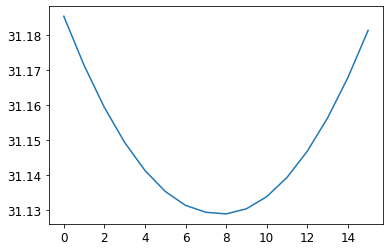

In [164]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(24,28,0.25))
plt.plot(angle_RMSE_list)

In [166]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

offset: 24.0 angle RMSE = 20.77052870355506
offset: 24.25 angle RMSE = 20.75568182269156
offset: 24.5 angle RMSE = 20.74383747584842
offset: 24.75 angle RMSE = 20.735000808392016
offset: 25.0 angle RMSE = 20.729175666765478
offset: 25.25 angle RMSE = 20.72636459013559
offset: 25.5 angle RMSE = 20.72656880486567
offset: 25.75 angle RMSE = 20.729788221842377
offset: 26.0 angle RMSE = 20.735946298406734
offset: 26.25 angle RMSE = 20.74510356635962
offset: 26.5 angle RMSE = 20.75726800587123
offset: 26.75 angle RMSE = 20.77243433389895
offset: 27.0 angle RMSE = 20.790595980989163
offset: 27.25 angle RMSE = 20.811745105427885
offset: 27.5 angle RMSE = 20.835872610041562
offset: 27.75 angle RMSE = 20.862968161564616
defocus RMSE = 5289.7262753369105


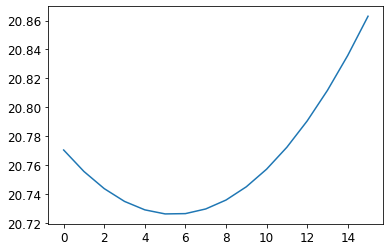

In [170]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(24,28,0.25),
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), norm_weights=True)
plt.plot(angle_RMSE_list)

## Cone fitting through ellipse projective fitting (attempt)

In [80]:
from scipy.stats import special_ortho_group
nsample=10000 #10000
ax = np.empty((nsample,3))
ay = np.empty((nsample,3))
az = np.empty((nsample,3))
ax[0,...] = [1,0,0]
ay[0,...] = [0,1,0]
az[0,...] = [0,0,1]
score_list = []
center, axis, theta_0, score= pred.fitEllipse(U_curated)
score_min = score
rotmat_min = np.diag([1,1,1])
center_min = center
ibest = 0
score_list.append(score)
print(ibest,score_min)
#rotmat_min = special_ortho_group.rvs(3)
for i in np.arange(1,nsample):
    rotmat = special_ortho_group.rvs(3)
    ax[i,...] = np.dot(rotmat,ax[0,...])
    ay[i,...] = np.dot(rotmat,ay[0,...])
    az[i,...] = np.dot(rotmat,az[0,...])
    U_rotated = np.dot(rotmat,U_curated[:,0:3].T).T
    center, axis, theta_0, score= pred.fitEllipse(U_rotated)
    if(score < score_min):
        score_min = score
        ibest = i
        rotmat_min = rotmat
        center_min = center
        print(i,score_min)
    score_list.append(score)

0 0.0002145138180975931
10 0.00018308552605749014
31 0.00017618784596981927
40 0.00016927663769117073
545 0.00016639013968847762
577 0.00016548819339864
1993 0.00016544130485197835
2997 0.00016528217632152836
5248 0.00016507850770754314


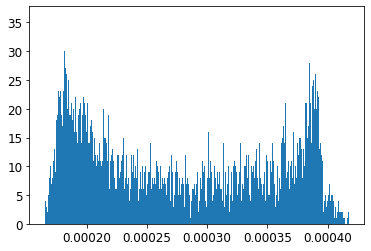

In [82]:
plt.hist(score_list, bins=np.int(nsample/10))
plt.show()

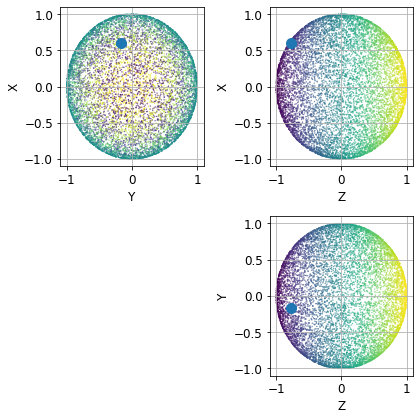

In [83]:
fig = plt.figure(figsize=(6,6))
plt.subplot(2,2,1)
plt.scatter(ax[:,1],ax[:,0],c=ax[:,2],s=0.1)
plt.scatter(ax[ibest,1],ax[ibest,0],s=100)
plt.xlabel('Y')
plt.ylabel('X')
plt.grid()
plt.subplot(2,2,2)
plt.scatter(ax[:,2],ax[:,0],c=ax[:,2],s=0.1)
plt.scatter(ax[ibest,2],ax[ibest,0],s=100)
plt.xlabel('Z')
plt.ylabel('X')
plt.grid()
plt.subplot(2,2,4)
plt.scatter(ax[:,2],ax[:,1],c=ax[:,2],s=0.1)
plt.scatter(ax[ibest,2],ax[ibest,1],s=100)
plt.xlabel('Z')
plt.ylabel('Y')
plt.grid()
plt.tight_layout()
plt.show()

In [84]:
print(rotmat_min, center_min)

[[ 0.6073048  -0.78691219  0.10931646]
 [-0.16569077  0.00911925  0.98613559]
 [-0.776999   -0.61699761 -0.12484592]] [ 0.00429805 -0.00469689]


In [85]:
U_best = np.dot(rotmat_min,U_curated[:,0:3].T).T#(np.dot(rotmat_min,U_curated[:,0:3].T).T)
print(U_best.shape, U_curated.shape)

(4798, 3) (4798, 4)


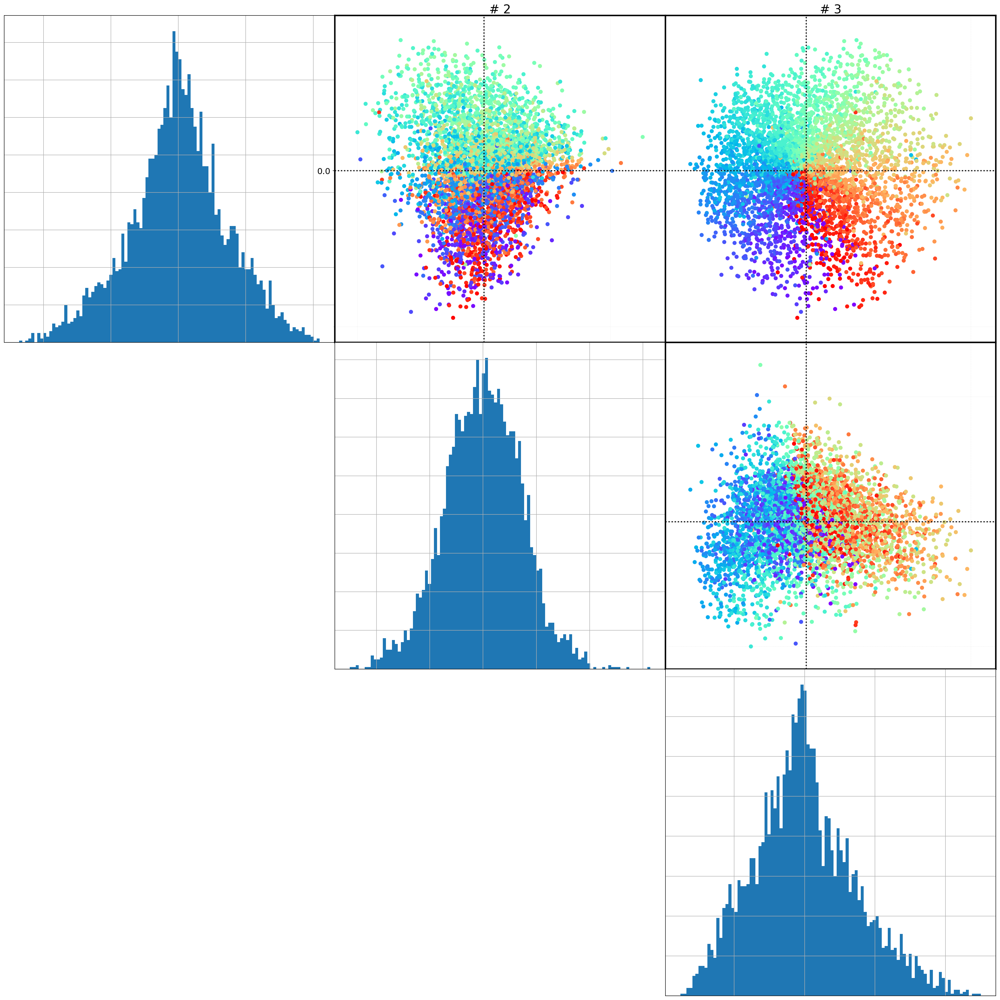

In [86]:
viz.biplots(U_best, n=3, show_histo=True, nbins=100, c=angle_true)

In [71]:
angle_best, defocus_best = pred.pred2d(U_best, angle_true, defocus_true, 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

In [72]:
defocus_best

array([16122.03407253,  9029.78224228,  7894.38415379, ...,
        9011.14904309, 16165.69594559,  8147.71788439])

In [73]:
print(np.linalg.norm(U_best - U_curated[:,0:3]))

2.7939598695782606


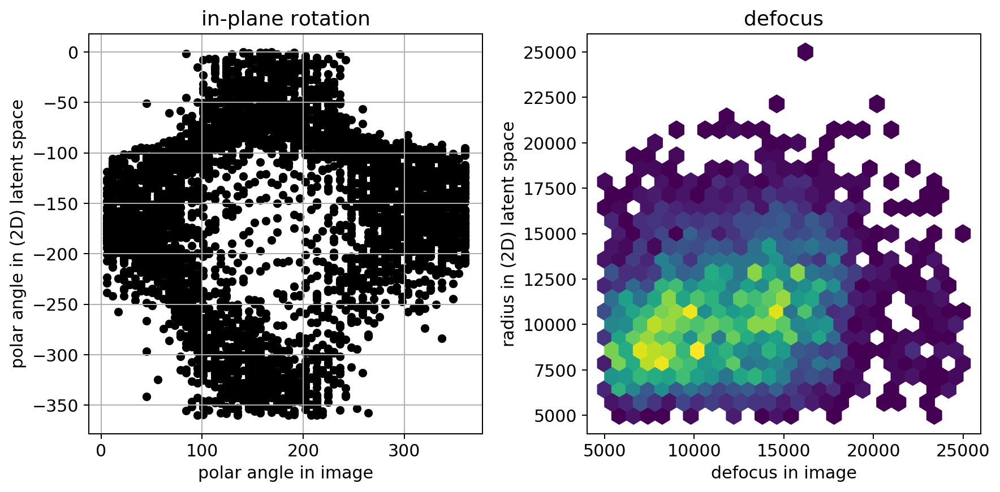

In [74]:
viz.plot_pred2d(angle_best, defocus_best, 
               angle_true, defocus_true)#, 
                #figname=KEYWORD+'/polar_prediction_ellipse_rest')

offset: -300 angle RMSE = 107.91643719893635
offset: -280 angle RMSE = 101.63281102609555
offset: -260 angle RMSE = 95.93971397724752
offset: -240 angle RMSE = 91.3470263731471
offset: -220 angle RMSE = 88.08999767308688
offset: -200 angle RMSE = 86.35385777984925
offset: -180 angle RMSE = 86.52567950101059
offset: -160 angle RMSE = 88.73778237110803
offset: -140 angle RMSE = 92.84229854344397
offset: -120 angle RMSE = 98.07967654791392
offset: -100 angle RMSE = 103.65789224329606
offset: -80 angle RMSE = 109.32268396626951
offset: -60 angle RMSE = 114.3206575890924
offset: -40 angle RMSE = 118.06572440448042
offset: -20 angle RMSE = 120.62830255378114
offset: 0 angle RMSE = 121.14435358678385
offset: 20 angle RMSE = 118.84918163590311
offset: 40 angle RMSE = 114.05856580173791
offset: 60 angle RMSE = 107.91643719893636
offset: 80 angle RMSE = 101.63281102609555
offset: 100 angle RMSE = 95.93971397724751
offset: 120 angle RMSE = 91.3470263731471
offset: 140 angle RMSE = 88.089997673086

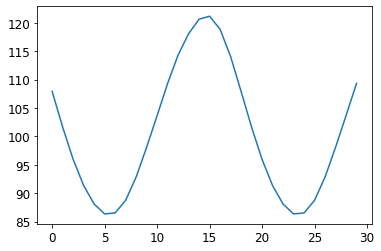

In [75]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_best, defocus_best, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-300,300,20))
plt.plot(angle_RMSE_list)

## Robust cone fitting (attempt)

In [ ]:
rho, theta = viz.cart2pol(U_curated[:,0], U_curated[:,1])

In [ ]:
def f_ellipse2d(theta, p):
    a, e = p
    return a * (1 - e**2)/(1 - e*np.cos(theta))

def residuals(p, r, theta):
    """ Return the observed - calculated residuals using f(theta, p). """
    return r - f_ellipse2d(theta, p)

def jac(p, r, theta):
    """ Calculate and return the Jacobian of residuals. """
    a, e = p
    da = (1 - e**2)/(1 - e*np.cos(theta))
    de = (-2*a*e*(1-e*np.cos(theta)) + a*(1-e**2)*np.cos(theta))/(1 -
                                                        e*np.cos(theta))**2
    return -da,  -de
    return np.array((-da, -de)).T

In [ ]:
from scipy import optimize
p0 = (1, 0.5)
plsq = optimize.leastsq(residuals, p0, Dfun=jac, args=(rho, theta), col_deriv=True)
print(plsq)

In [ ]:
params, ell_coord = pred.fitEllipse(U_curated[:,0:2],1)

In [ ]:
ell_coord.shape

In [ ]:
rho_fitEll, theta_fitEll = viz.cart2pol(ell_coord[:,0],ell_coord[:,1])

In [ ]:
import pylab
pylab.polar(theta, rho, 'x')
theta_grid = np.linspace(0, 2*np.pi, 200)
pylab.polar(theta_grid, f_ellipse2d(theta_grid, plsq[0]), lw=2)
pylab.polar(theta_fitEll,rho_fitEll, 'o')
pylab.show()

## General quadric fitting

In [ ]:
# eventually just keep the first data points (for rapid testing)
sub_sample = U_curated.shape[0] 
# define data array to be fitted
data = U_curated[0:sub_sample,0:3]
# add t vector to data, and define y=0 vector
x = np.concatenate((data.T,np.ones((1,data.shape[0]))),axis=0)
y = np.zeros(data.shape[0])
print(x.shape, y.shape)

In [ ]:
viz.biplots(data, n=3, show_histo=True, nbins=100, c=angle_curated[0:sub_sample])

In [ ]:
dim = x.shape[0]
popt, pcov = pred.curve_fit(pred.quadric_model,
                       x,y,
                       p0=np.ones((np.int(dim*(dim+1)/2))) #p0=[1,-1,-1,0,0,0,0,0,0,0.1]
                      )

In [ ]:
fitData = pred.quadric_model(x, *popt)
plt.hist(fitData, bins=100)
plt.show()

In [ ]:
A = pred.quadric_matrix(4,*popt)
print(A)
plt.imshow(A)
plt.colorbar()
plt.show()

In [ ]:
D, P = np.linalg.eig(A)
print(np.linalg.det(np.diag(D)), np.linalg.matrix_rank(A))
plt.plot(D, 'X')
plt.grid()
plt.show()
plt.imshow(P)
plt.colorbar()

### Projection in reduced space

In [ ]:
x_oriented = np.dot(P,x).T
x_oriented.shape

In [ ]:
viz.biplots(x_oriented, n=4, show_histo=True, nbins=100, c=defocus_curated[0:sub_sample])

In [ ]:
viz.biplots(x_oriented, n=4, show_histo=True, nbins=100, c=angle_curated[0:sub_sample])

### Final rescaling 

In [ ]:
x_scaled = np.copy(x_oriented)
for i in np.arange(3):
    x_scaled[:,i] /= x_oriented[:,3]
    #x_scaled[:,i] /= 1e12*np.maximum(x_oriented[:,3],1e-12)

In [ ]:
viz.biplots(x_scaled, n=3, show_histo=True, nbins=100, c=defocus_curated[0:sub_sample])

In [ ]:
viz.biplots(x_scaled, n=3, show_histo=True, nbins=100, c=angle_curated[0:sub_sample])